Continuing to zero-in in on an improved portfolio, using Golden Butterfly assets and adding REIT.
Could add other assets like international stocks, but I think I'll just keep my bit of Emerging Markets,
and focus on these simple 6 assets.

Here's the starting point (same as from 2022-08-04):
 - 20% TSM
 - 20% SCV
 - 10% LTT  (I like this reduced exposure to LTT)
 - 20% STT
 - 15% REIT (I like the exposure to REIT, seems like a workhorse)
 - 15% GLD  (I like the slightly reduced exposure to GLD, who knows if Bitcoin is going to replace it in portfolios)

I want to try out different "cash-like" options as well, namely TIPS.

In [2]:
import pandas as pd
import sqlite3
import seaborn as sns

# Read sqlite query results into a pandas DataFrame
def query(query):
    con = sqlite3.connect("output/portfolios_varying_percentages.sqlite")
    df = pd.read_sql_query(query, con)
    con.close()
    return df

7557


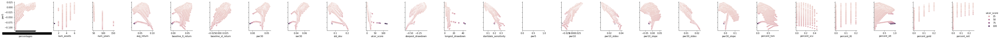

In [3]:
# get a sense of the shape of the graphs (ran with percentages in 5% steps)
df = query("""
  SELECT * FROM portfolios
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr5'], x_vars=df.columns.values[1:], hue='ulcer_score')

725


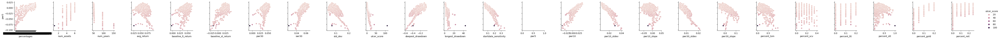

In [7]:
# random sampling of just 10% of the rows
df = query("""
  SELECT * FROM portfolios
  WHERE abs(random() % 10) < 1
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr5'], x_vars=df.columns.values[1:], hue='ulcer_score')

265


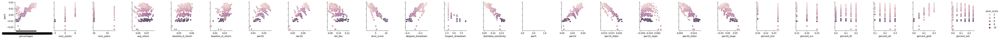

In [10]:
# focus on slight variations around my current favorite
df = query("""
  SELECT * FROM portfolios
  WHERE abs(percent_tsm - 0.20) <= 0.05
    AND abs(percent_scv - 0.20) <= 0.05
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.10
    AND abs(percent_gold - 0.15) <= 0.5
    AND abs(percent_reit - 0.15) <= 0.5
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr5'], x_vars=df.columns.values[1:], hue='ulcer_score')

148


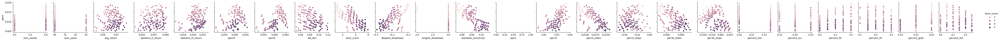

In [12]:
# tighten: pwr5
df = query("""
  SELECT * FROM portfolios
  WHERE pwr5 > 0.005
    AND abs(percent_tsm - 0.20) <= 0.05
    AND abs(percent_scv - 0.20) <= 0.05
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.10
    AND abs(percent_gold - 0.15) <= 0.5
    AND abs(percent_reit - 0.15) <= 0.5
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr5'], x_vars=df.columns.values[2:], hue='ulcer_score')

481


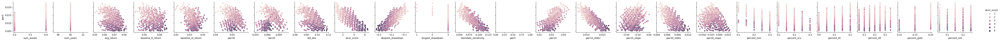

In [13]:
# adjust allowed ranges
df = query("""
  SELECT * FROM portfolios
  WHERE pwr5 > 0.005
    AND abs(percent_tsm - 0.20) <= 0.10
    AND abs(percent_scv - 0.20) <= 0.10
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.15
    AND abs(percent_gold - 0.15) <= 0.10
    AND abs(percent_reit - 0.15) <= 0.10
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr5'], x_vars=df.columns.values[2:], hue='ulcer_score')

323


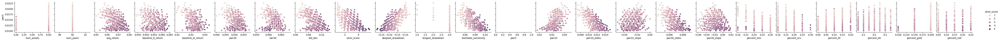

In [14]:
# tighten: pwr5
df = query("""
  SELECT * FROM portfolios
  WHERE pwr5 > 0.01
    AND abs(percent_tsm - 0.20) <= 0.10
    AND abs(percent_scv - 0.20) <= 0.10
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.15
    AND abs(percent_gold - 0.15) <= 0.10
    AND abs(percent_reit - 0.15) <= 0.10
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr5'], x_vars=df.columns.values[2:], hue='ulcer_score')

323


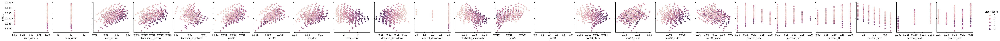

In [15]:
# y-axis: pwr10
df = query("""
  SELECT * FROM portfolios
  WHERE pwr5 > 0.01
    AND abs(percent_tsm - 0.20) <= 0.10
    AND abs(percent_scv - 0.20) <= 0.10
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.15
    AND abs(percent_gold - 0.15) <= 0.10
    AND abs(percent_reit - 0.15) <= 0.10
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue='ulcer_score')

8734


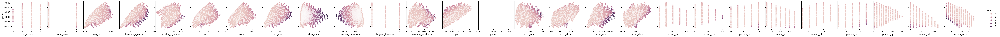

In [16]:
# added assets: TIPS, T-Bill
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5 > 0.01
    AND abs(percent_tsm - 0.20) <= 0.10
    AND abs(percent_scv - 0.20) <= 0.10
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.15
    AND abs(percent_gold - 0.15) <= 0.10
    AND abs(percent_reit - 0.15) <= 0.10
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue='ulcer_score')

2103


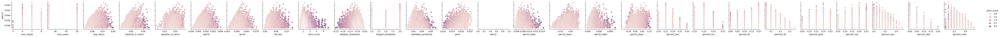

In [17]:
# tighten: pwr10
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5 > 0.01
    AND pwr10 > 0.035
    AND abs(percent_tsm - 0.20) <= 0.10
    AND abs(percent_scv - 0.20) <= 0.10
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.15
    AND abs(percent_gold - 0.15) <= 0.10
    AND abs(percent_reit - 0.15) <= 0.10
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue='ulcer_score')

2103


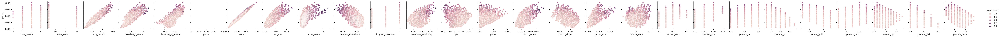

In [18]:
# look at pwr30
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5 > 0.01
    AND pwr10 > 0.035
    AND abs(percent_tsm - 0.20) <= 0.10
    AND abs(percent_scv - 0.20) <= 0.10
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.15
    AND abs(percent_gold - 0.15) <= 0.10
    AND abs(percent_reit - 0.15) <= 0.10
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue='ulcer_score')

732


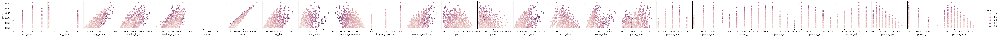

In [19]:
# tighten: pwr30
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.035
    AND pwr30 > 0.05
    AND abs(percent_tsm - 0.20) <= 0.10
    AND abs(percent_scv - 0.20) <= 0.10
    AND abs(percent_ltt - 0.10) <= 0.10
    AND abs(percent_stt - 0.20) <= 0.15
    AND abs(percent_gold - 0.15) <= 0.10
    AND abs(percent_reit - 0.15) <= 0.10
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue='ulcer_score')

3660


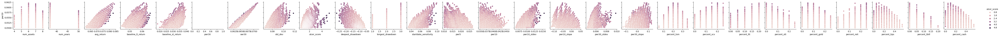

In [20]:
# remove asset percentage restrictions
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.035
    AND pwr30 > 0.05
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue='ulcer_score')

3660


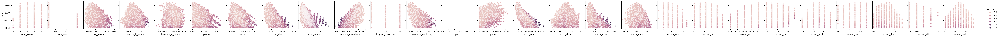

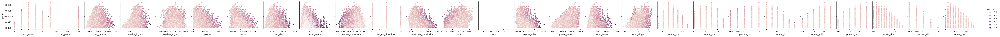

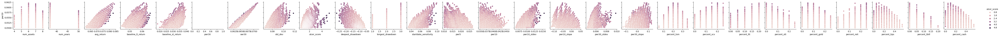

In [22]:
# y-axis: pwr5, pwr10, pwr30
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.035
    AND pwr30 > 0.05
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue='ulcer_score')
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue='ulcer_score')
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue='ulcer_score')

3660


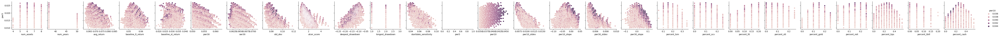

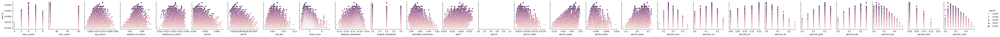

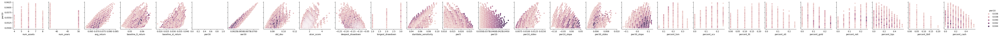

In [23]:
# hue: pwr10 (thinking to increase pwr10 limit)
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.035
    AND pwr30 > 0.05
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
hue='pwr10'
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue=hue)

2296


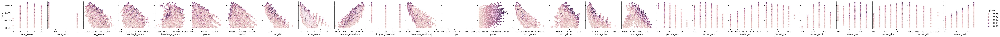

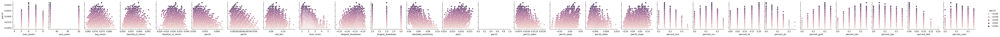

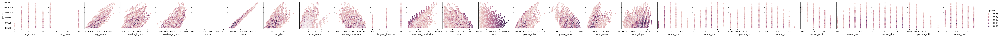

In [24]:
# tighten: percent_cash
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.035
    AND pwr30 > 0.05
    AND percent_cash <= 0.25
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
hue='pwr10'
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue=hue)

217


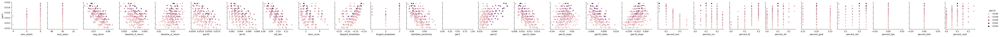

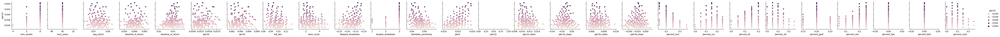

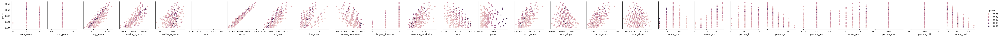

In [25]:
# cash: STT only
df = query("""
  SELECT *,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.035
    AND pwr30 > 0.05
    AND percent_cash <= 0.25
    AND percent_tips  = 0
    AND percent_tbill = 0
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
hue='pwr10'
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue=hue)

2296


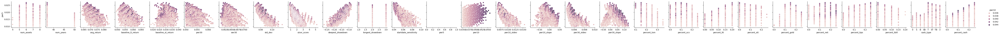

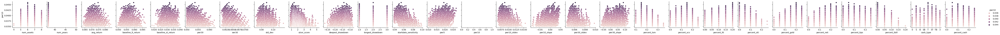

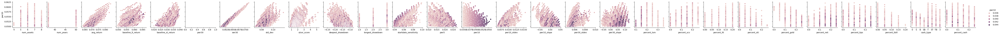

In [30]:
# add column: cash_type
df = query("""
  SELECT *,
        CASE
          WHEN (percent_stt = 0 AND percent_tips = 0 AND percent_tbill = 0) THEN "0"
          WHEN (percent_stt > 0 AND percent_tips = 0 AND percent_tbill = 0) THEN "S"
          WHEN (percent_stt = 0 AND percent_tips > 0 AND percent_tbill = 0) THEN "T"
          WHEN (percent_stt = 0 AND percent_tips = 0 AND percent_tbill > 0) THEN "B"
          WHEN (percent_stt > 0 AND percent_tips > 0 AND percent_tbill = 0) THEN "ST"
          WHEN (percent_stt > 0 AND percent_tips = 0 AND percent_tbill > 0) THEN "SB"
          WHEN (percent_stt = 0 AND percent_tips > 0 AND percent_tbill > 0) THEN "TB"
          WHEN (percent_stt > 0 AND percent_tips > 0 AND percent_tbill > 0) THEN "3"
          ELSE "?"
        END as cash_type,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.035
    AND pwr30 > 0.05
    AND percent_cash <= 0.25
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
hue='pwr10'
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue=hue)

1442


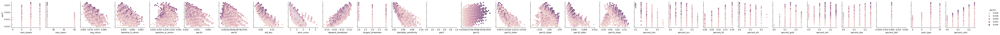

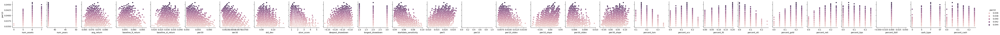

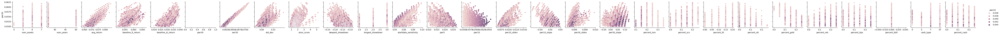

In [31]:
# Looks like T-Bills are 3rd best, TIPS is probably best, but maybe STT is a contender..
# remove rows with T-Bills
df = query("""
  SELECT *,
        CASE
          WHEN (percent_stt = 0 AND percent_tips = 0) THEN "0"
          WHEN (percent_stt > 0 AND percent_tips = 0) THEN "S"
          WHEN (percent_stt = 0 AND percent_tips > 0) THEN "T"
          WHEN (percent_stt > 0 AND percent_tips > 0) THEN "ST"
          ELSE "?"
        END as cash_type,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.035
    AND pwr30 > 0.05
    AND percent_cash <= 0.25
    AND percent_tbill = 0
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
hue='pwr10'
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue=hue)

358


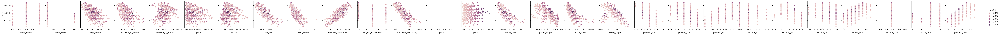

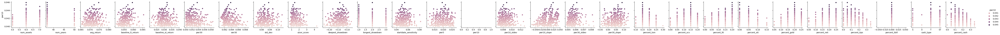

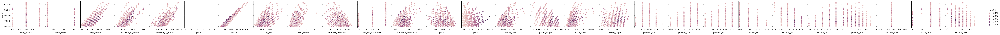

In [32]:
# tighten: pwr10
df = query("""
  SELECT *,
        CASE
          WHEN (percent_stt = 0 AND percent_tips = 0) THEN "0"
          WHEN (percent_stt > 0 AND percent_tips = 0) THEN "S"
          WHEN (percent_stt = 0 AND percent_tips > 0) THEN "T"
          WHEN (percent_stt > 0 AND percent_tips > 0) THEN "ST"
          ELSE "?"
        END as cash_type,
        (percent_stt + percent_tips + percent_tbill) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.04
    AND pwr30 > 0.05
    AND percent_tbill = 0
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
hue='pwr10'
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue=hue)

358


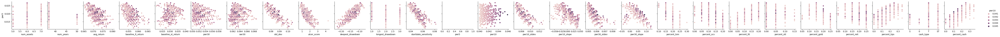

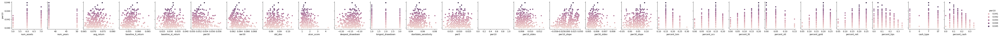

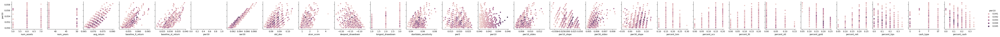

In [35]:
# re-ran Go export, dropped tbills from consideration
df = query("""
  SELECT *,
        CASE
          WHEN (percent_stt = 0 AND percent_tips = 0) THEN "0"
          WHEN (percent_stt > 0 AND percent_tips = 0) THEN "S"
          WHEN (percent_stt = 0 AND percent_tips > 0) THEN "T"
          WHEN (percent_stt > 0 AND percent_tips > 0) THEN "ST"
          ELSE "?"
        END as cash_type,
        (percent_stt + percent_tips) AS percent_cash
  FROM portfolios
  WHERE pwr5  > 0.01
    AND pwr10 > 0.04
    AND pwr30 > 0.05
  ORDER BY ulcer_score DESC
""")
print(df['assets'].size)
hue='pwr10'
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue=hue)

2


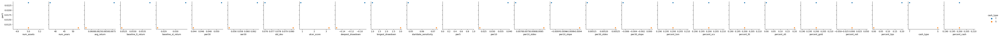

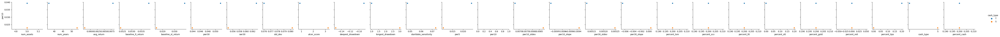

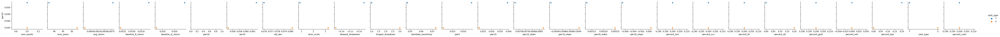

In [42]:
# Can just switch from STT to TIPS? Let's compare GB
hue='cash_type'
df = query("""
  SELECT *,
        CASE
          WHEN (percent_stt = 0 AND percent_tips = 0) THEN "0"
          WHEN (percent_stt > 0 AND percent_tips = 0) THEN "S"
          WHEN (percent_stt = 0 AND percent_tips > 0) THEN "T"
          WHEN (percent_stt > 0 AND percent_tips > 0) THEN "ST"
          ELSE "?"
        END as cash_type,
        (percent_stt + percent_tips) AS percent_cash
  FROM portfolios
  WHERE
    -- select specific portfolios
    (
         (assets='|TSM|SCV|LTT|STT|Gold|'  AND percentages='|20%|20%|20%|20%|20%|')
      OR (assets='|TSM|SCV|LTT|Gold|TIPS|' AND percentages='|20%|20%|20%|20%|20%|')
    )
  ORDER BY """+hue+""" DESC
""")
print(df['assets'].size)
sns.pairplot(df, y_vars=['pwr5'],  x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr10'], x_vars=df.columns.values[2:], hue=hue)
sns.pairplot(df, y_vars=['pwr30'], x_vars=df.columns.values[2:], hue=hue)

In [45]:
# Holy crap, TIPS is dramatically better than STT!!
df = query("""
SELECT *
FROM portfolios
WHERE
    (assets='|TSM|SCV|LTT|STT|Gold|'  AND percentages='|20%|20%|20%|20%|20%|')
    OR (assets='|TSM|SCV|LTT|Gold|TIPS|' AND percentages='|20%|20%|20%|20%|20%|')""")
df

,assets,percentages,num_assets,num_years,avg_return,baseline_lt_return,baseline_st_return,pwr30,swr30,std_dev,...,pwr10_slope,pwr30_stdev,pwr30_slope,percent_tsm,percent_scv,percent_ltt,percent_stt,percent_gold,percent_reit,percent_tips
0,|TSM|SCV|LTT|Gold|TIPS|,|20%|20%|20%|20%|20%|,5,37,0.068191,0.053908,0.030863,0.051372,0.063200,0.076001,...,-0.009753,0.005129,-0.006556,0.2,0.2,0.2,0.0,0.2,0.0,0.2
1,|TSM|SCV|LTT|STT|Gold|,|20%|20%|20%|20%|20%|,5,53,0.058028,0.052409,0.028491,0.043933,0.054645,0.080273,...,-0.009372,0.005249,0.000524,0.2,0.2,0.2,0.2,0.2,0.0,0.0


In [46]:
# Geez, incredible difference with TIPS vs. STT:
#  - Deepest drawdown:   -8.8% instead of -15.2%
#  - Longest drawdown:  1 year instead of 3 years
#  - Ulcer score:         0.88 instead of 3.22
#  - Min PWR (5 years):  2.39% instead of 1.07%
#  - Min PWR (10 years): 3.93% instead of 2.28%
#  - Min PWR (30 years): 5.14% instead of 4.39%

# Hmm, maybe a contributing factor is there is only 37 years of data for TIPS vs 53 years of STT.
# Should compare those two portfolios against one another, for the same time frame, before getting too excited
# about their difference.